In [1]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (10,8)
import matplotlib.font_manager
import seaborn as sns
import anndata
import scanpy as sc
import scvi
import re
import warnings

warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")


/well/immune-rep/users/vbw431/conda/skylake/envs/scvi_tools_gpu/lib/python3.11/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/well/immune-rep/users/vbw431/conda/skylake/envs/scvi_tools_gpu/lib/python3.11/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/well/immune-rep/users/vbw431/conda/skylake/envs/scvi_tools_gpu/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/well/immune-rep/users/vbw431/conda/skylake/envs/scvi_tools_gpu/lib/python3.11/site-packages/flax/struct

In [2]:
print(pd.__version__)

1.5.3


In [3]:
data_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/"
newdata_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_analysis/data/"
plot_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/"



In [4]:
adata = sc.read_h5ad("/well/immune-rep/users/vbw431/Projects/Peppa/out/peppa_azi_combat.h5ad")
##load data
labels = ["NK", "CD8", "CD4", "Bcells", "Myeloid_Plt"]
cluster_list = {}
scvi_list = {}
umap_list = {}
for i in [0,1,2,3,4]:
    print("reading in " + labels[i])
    cluster_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_clustering_final/", f"Peppa_{labels[i]}_cluster_assignment.csv"), index_col =0)
    scvi_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_scvi.csv"), index_col =0)
    umap_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_umap.csv"), index_col =0)

adata_list = {}

for i in [0,1,2,3, 4]:
    adata_list[labels[i]] = adata[cluster_list[labels[i]].index].copy()
    adata_list[labels[i]].obsm["X_scVI"] = scvi_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obsm["X_umap"] = umap_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obs = adata_list[labels[i]].obs.merge(cluster_list[labels[i]], left_index=True, right_index=True, how="inner")
    adata_list[labels[i]].layers['counts'] = adata_list[labels[i]].X.copy()
    sc.pp.normalize_total(adata_list[labels[i]], target_sum=1e4)
    sc.pp.log1p(adata_list[labels[i]])
    adata_list[labels[i]].layers['normalized'] = adata_list[labels[i]].X.copy()
 

reading in NK
reading in CD8
reading in CD4
reading in Bcells
reading in Myeloid_Plt


In [5]:
##update meta_data with new clinical
clin_meta = pd.read_csv(newdata_dir + "index_demo.csv", index_col = 0)
clin_meta = clin_meta[["disease_group", 
                       "bio_replicate", 
                       "study_disease", 
                       "scanpy_index", 
                       "study_ID", 
                       "Treatment_status",
                      "Ethnicity",
                      "Sex",
                      "Age",
                      "HBV_serostatus",
                      "HBV_sAg_titre",
                      "HBV_DNA_VL"]]
clin_meta

,disease_group,bio_replicate,study_disease,scanpy_index,study_ID,Treatment_status,Ethnicity,Sex,Age,HBV_serostatus,HBV_sAg_titre,HBV_DNA_VL
1.0,HBV-Rx,patient_12,HBV,PBMC_NA,AM64.3,On_treatment,White_caucasian,M,55.0,sAg+:eAg:eAb+,307.000000,0.0
2.0,HBV-Rx,patient_11,HBV,HBV_C_Hashtag.1,CB75.3,On_treatment,BAME,M,44.0,sAg+:eAg-:eAb+,279.000000,22.0
3.0,CTRL-Prep,control_1,CTRL,HBV_C_Hashtag.2,J2067,On_PrEP,White_caucasian,M,46.0,Not_available,NaN,NaN
4.0,HBV_HIV-Rx,patient_10,HBV_HIV,HIVHBV_C_Hashtag.1,RFH-HB004,On_treatment,BAME,M,44.0,sAg+:eAg-:eAb+,208.000000,0.0
5.0,CTRL-Prep,control_1,CTRL,HIVHBV_C_Hashtag.2,J2067,On_PrEP,White_caucasian,M,46.0,Not_available,NaN,NaN
6.0,HBV-Pre,patient_1,HBV,HBV_Tre_1_Hashtag.1,1391,Pre_treatment,White_caucasian,F,55.0,sAg+:eAg-:eAb+,2479.000000,3917.0
7.0,HBV-Rx,patient_1,HBV,HBV_Tre_1_Hashtag.2,1522,On_treatment,White_caucasian,F,56.0,sAg+:eAg-:eAb+,2544.000000,20.0
8.0,HBV-Pre,patient_2,HBV,HBV_Tre_2_Hashtag.1,1380,Pre_treatment,BAME,M,34.0,sAg+:eAg-:eAb+,7303.000000,1381.0
9.0,HBV-Rx,patient_2,HBV,HBV_Tre_2_Hashtag.2,1564,On_treatment,BAME,M,35.0,sAg+:eAg-:eAb+,7765.000000,20.0
10.0,HBV-Pre,patient_3,HBV,HBV_Tre_3_Hashtag.1,1639,Pre_treatment,Chinese,M,53.0,sAg+:eAg-:eAb+,27.000000,9033.0


In [6]:
new_obs = {}

for name in labels:
    del adata_list[name].obs["disease_group"]
    del adata_list[name].obs["study_disease"]
    new_df = pd.merge(adata_list[name].obs, clin_meta, how='left', left_on = ['bio_replicate','scanpy_index'], right_on = ['bio_replicate','scanpy_index'])
    new_df.index = adata_list[name].obs.index
    new_obs[name] = new_df.copy()
    adata_list[name].obs = new_df.copy()

      

In [7]:
for name in labels:
    adata_list[name].obs["celltype_consensus.l1"] = str(name)
    adata_list[name].obs["celltype_consensus.l2"] = adata_list[name].obs[str(name+".annotation.l1")]
    adata_list[name].obs["celltype_consensus.l3"] = adata_list[name].obs[str(name+".annotation.l2")]

In [8]:
vae = scvi.model.SCVI.load("/well/immune-rep/users/vbw431/Projects/Peppa/scvi/updated_model")


INFO     File /well/immune-rep/users/vbw431/Projects/Peppa/scvi/updated_model/model.pt already downloaded          


No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


In [9]:
##concat
adata_all = anndata.concat(adata_list, join= "outer", index_unique=None)


In [10]:
scvi.model.SCVI.prepare_query_anndata(adata_all, vae)

##assign batch for azimuth and combat
conditions = [
    (adata_all.obs["orig.ident"].isin(["SeuratProject"])),
    (~adata_all.obs["orig.ident"].isin(["SeuratProject"])),
 ]

# create a list of the values we want to assign for each condition
values = [adata_all.obs["sample_ID"], adata_all.obs["orig.ident"]]

# create a new column and use np.select to assign values to it using our lists as arguments
adata_all.obs["scvi_batch"] = np.select(conditions, values)
adata_all.obs["scvi_batch"].unique().tolist()

INFO     Found 100.0% reference vars in query data.                                                                


['HIVHBV_C',
 'HH_Tre_4',
 'HBV_Tre_1',
 'HIVHBV_Tre_5',
 'HBV_Tre_3',
 'HBV_X2',
 'HBV_C',
 'HIVHBV_X2',
 'HBV_Tre_2',
 'Healthy',
 'P1_3',
 'P2_7',
 'P4_7',
 'P2_3',
 'P1_7',
 'P2_0',
 'P4_3',
 'P1_0',
 'P4_0',
 'P8_0',
 'P8_3',
 'P5_3',
 'P8_7',
 'P5_7',
 'P5_0']

In [11]:
adata_all.obsm["X_scVI"] = vae.get_latent_representation(adata_all)



INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             


In [12]:
sc.pp.neighbors(adata_all, use_rep="X_scVI", metric="cosine",n_neighbors=20)
sc.tl.umap(adata_all)


In [13]:
pd.DataFrame(adata_all.obsm["X_umap"], index=adata_all.obs_names).to_csv(data_dir+"umap_all_emb.csv")


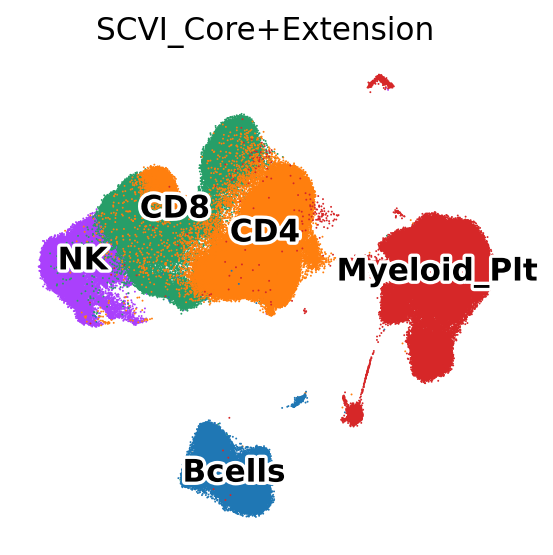

In [15]:
sc.set_figure_params(vector_friendly=True, dpi_save=1000)
#del adata_all.uns["celltype_consensus.l1_colors"]
sc.pl.umap(
        adata_all,
        color=["celltype_consensus.l1"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        legend_loc='on data',
        legend_fontoutline = 3,
        size=3,
    save = "SCVI_peppa_azimuth_umap.pdf"
)


In [16]:
#density
sc.pp.subsample(adata_all, fraction =0.3)


In [17]:
sc.tl.embedding_density(adata_all, basis='umap', groupby='study_disease')


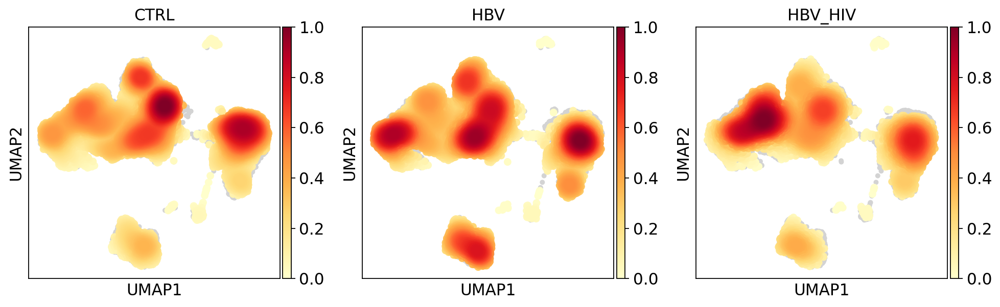

In [18]:
sc.set_figure_params(vector_friendly=True, dpi_save=400)
sc.pl.embedding_density(adata_all, 
                        basis='umap', 
                        key='umap_density_study_disease',
                        save = "SCVI_peppa_azimuth_umap_density.pdf"
                       )


In [20]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14, dpi_save=1000, figsize = (8,8))
#del adata_all.uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_all,
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="Celltype annotation",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        size=3,
    save = "SCVI_peppa_azimuth_umap_annot.png"
)

In [21]:
for label in labels:
    sc.tl.embedding_density(adata_list[label], basis='umap', groupby='study_disease')


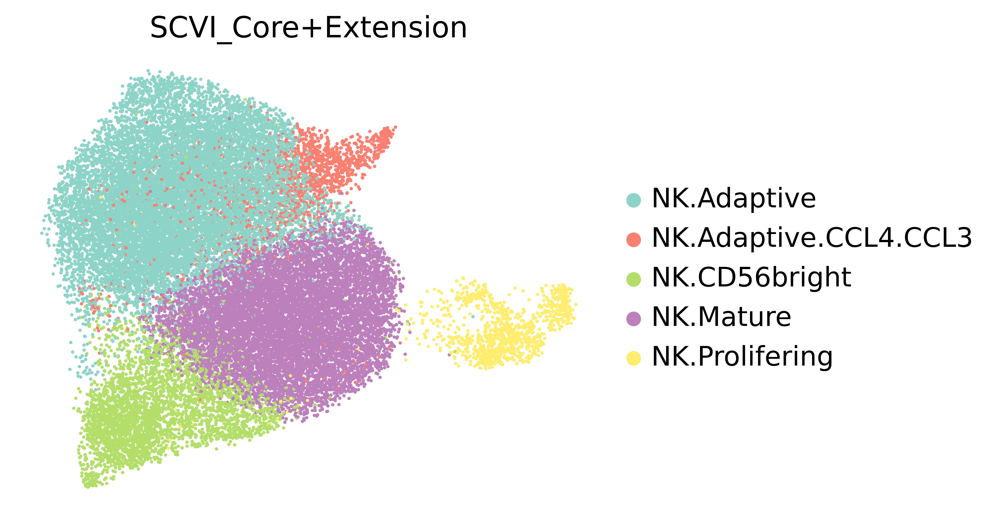

In [22]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (5,4))
#adata_list["NK"].uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_list["NK"],
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        palette = 'Set3',
        size=10,
    save = "SCVI_peppa_azimuth_umap_NK_l2.pdf"
)
plt.show()
sc.pl.embedding_density(adata_list["NK"], basis='umap', key='umap_density_study_disease')
plt.show()

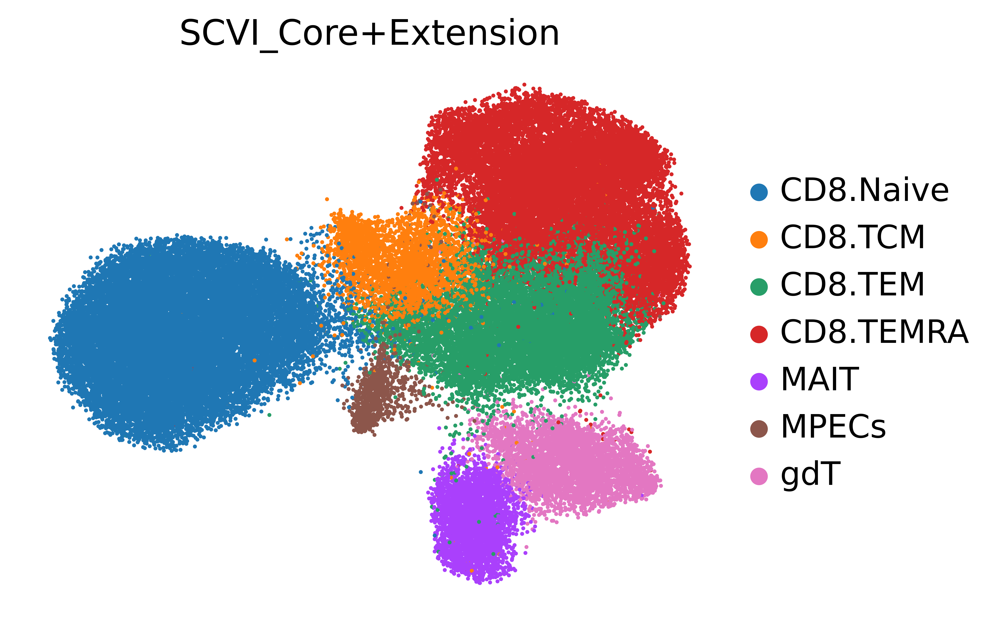

In [23]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (5,4))
#del adata_list["CD8"].uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_list["CD8"],
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        #palette = 'Set2',
        size=10,
    save = "SCVI_peppa_azimuth_umap_CD8_l2.pdf"
)
plt.show()
sc.pl.embedding_density(adata_list["CD8"], basis='umap', key='umap_density_study_disease')
plt.show()

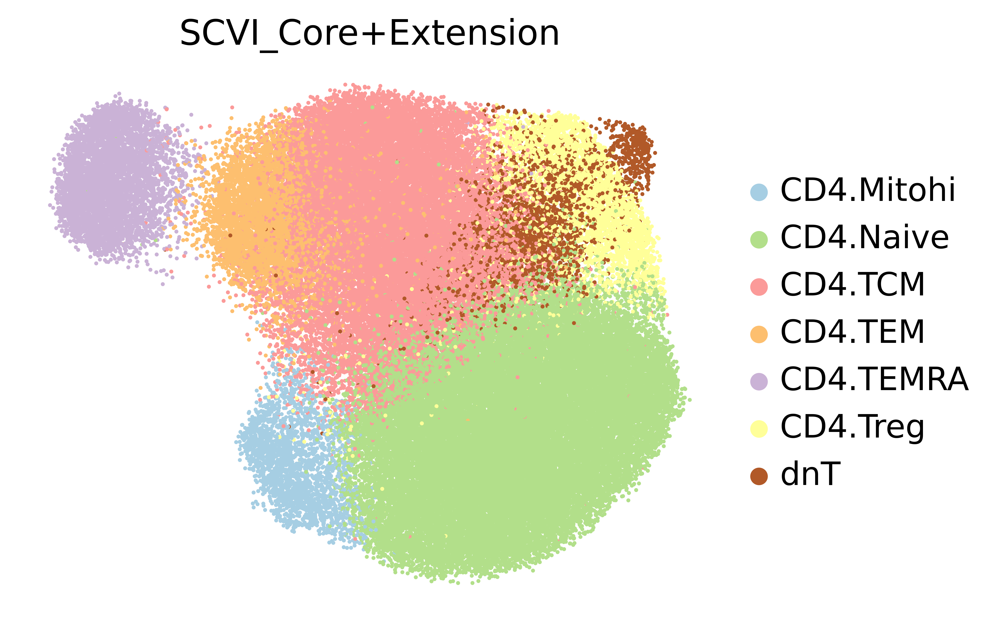

In [24]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (5,4))
#del adata_list["CD4"].uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_list["CD4"],
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        palette = 'Paired',
        size=10,
    save = "SCVI_peppa_azimuth_umap_CD4_l2.pdf"
)
plt.show()
sc.pl.embedding_density(adata_list["CD4"], basis='umap', key='umap_density_study_disease')
plt.show()

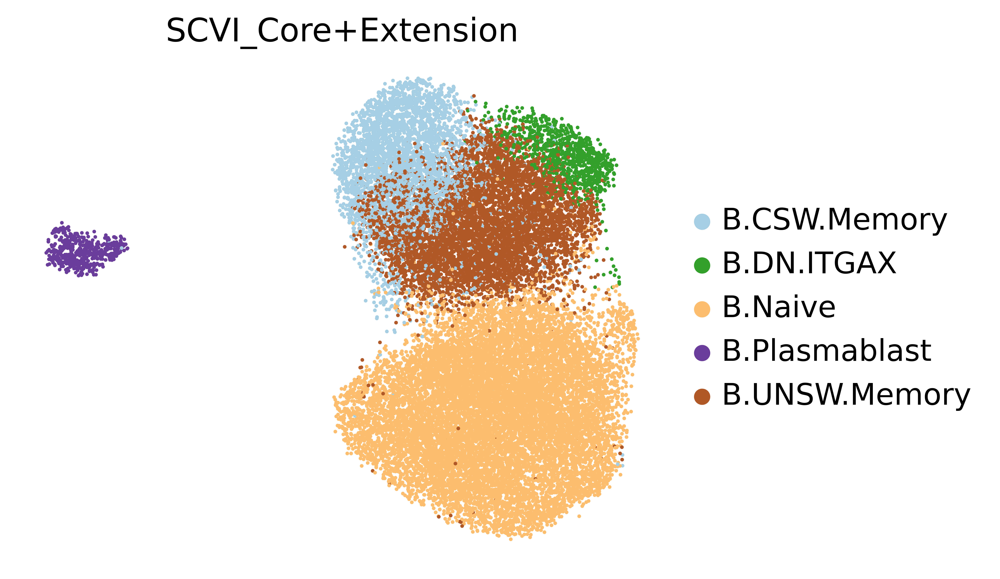

In [25]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (5,4))
#del adata_list["CD4"].uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_list["Bcells"],
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        palette = 'Paired',
        size=10,
    save = "SCVI_peppa_azimuth_umap_Bcells_l2.pdf"
)
plt.show()
sc.pl.embedding_density(adata_list["Bcells"], basis='umap', key='umap_density_study_disease')
plt.show()

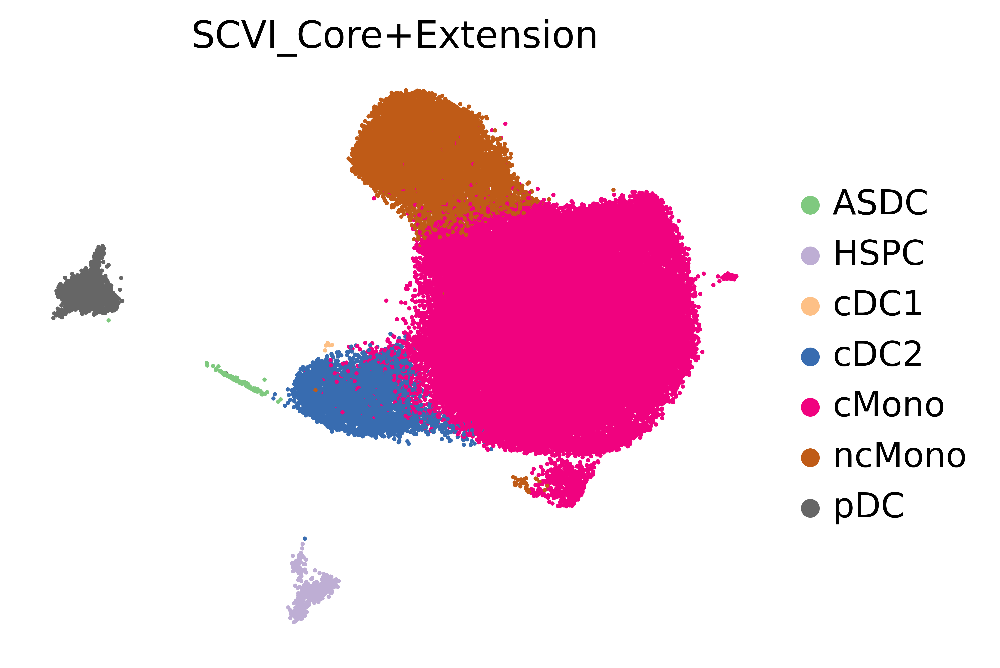

In [26]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (5,4))
#del adata_list["CD4"].uns["celltype_consensus.l2_colors"]
sc.pl.umap(
        adata_list["Myeloid_Plt"],
        color=["celltype_consensus.l2"],
        frameon=False,
        ncols=1,
        title="SCVI_Core+Extension",
        #legend_loc='on data',
        #legend_fontoutline = 3,
        palette = 'Accent',
        size=10,
    save = "SCVI_peppa_azimuth_umap_Myeloid_Plt_l2.pdf"
)
plt.show()
sc.pl.embedding_density(adata_list["Myeloid_Plt"], basis='umap', key='umap_density_study_disease')
plt.show()

In [27]:
adata_full = anndata.concat(adata_list, join= "outer", index_unique=None)


In [28]:
adata_full.X = adata_full.layers["counts"].copy()
sc.pp.normalize_total(adata_full, target_sum=1e4)
sc.pp.log1p(adata_full)
   

In [32]:
adata_full

AnnData object with n_obs × n_vars = 252811 × 23789
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample_ID', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'percent.mt', 'percent.ribo', 'percent.Ig', 'S.Score', 'G2M.Score', 'Phase', 'CITE_present', 'nCount_CITE', 'nFeature_CITE', 'nCount_protein_counts', 'nFeature_protein_counts', 'Hashtag.1', 'Hashtag.2', 'QC_label', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'solo_doublet_prob', 'solo_singlet_prob', 'solo_classification', 'nCount_CITE_seurat', 'nFeature_CITE_seurat', 'batch', 'scanpy_index', 'bio_replicate', 'CMV_status', 'Ref_lab', 'sample_id', 'nCount_ADT', 'nFeature_ADT', 'lane', 'donor', 'time', 'celltype.l1', 'celltype.l2', 'celltype.l3', 'nCount_SCT', 'nFeature_SCT', 'X_index', 'n_genes_by_counts', 'total_counts

In [33]:
#adata_full.obs = adata_all.obs[]
#adata_full.obsm["X_scVI"] = adata_all.obsm["X_scVI"]

In [34]:
sc.tl.rank_genes_groups(adata_full, groupby='celltype_consensus.l2')


In [35]:
sc.tl.dendrogram(adata_full, groupby='celltype_consensus.l2', use_rep = "X_scVI")


#marker_genes_dict = {
    #'B': ['CD79A', 'MS4A1'],
    #'DC': ['FCER1A', 'CST3'],
    #'Mono': ['FCGR3A'],
    #'NK': ['GNLY', 'NKG7'],
    #'PB': ['MZB1'],
    #'T': ['CD3D'],
#}

In [ ]:
sc.tl.filter_rank_genes_groups(adata_full)



In [ ]:
top10 = pd.DataFrame(adata_full.uns['rank_genes_groups_filtered']['names']).head(10)

In [ ]:
markerlist = pd.unique(top10.values.ravel('K'))
markerlist = np.delete(markerlist, 2)
markerlist

In [ ]:
#sc.set_figure_params(scanpy=True, dpi=500, fontsize=20,dpi_save=300, frameon=True, vector_friendly=True, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')


sc.pl.matrixplot(adata_full, 
                markerlist,
                groupby="celltype_consensus.l2", 
                 cmap='Blues', 
                 dendrogram=True, 
                  standard_scale='var',
                 save = "allcluster_heatmap.pdf")



In [ ]:
marker_genes_dict = {'B cells': ['CD79A', 'MS4A1', 'IGHM','IGHD','TCL1A','CD27','IGHG1','FCRL5','ITGAX','XBP1','COTL1'],
                     'CD4': ['FOXP3', 'TIGIT','TCF7','LIMS1', 'AQP3', 'ISG20'],
                     'CD8': ['CD8A','IL7R','CCR7','GZMA','GZMH','GZMB','SLC4A10','CCL5','PDCD1','TRGV9','TRDV2','KLRD1'],
                     'NK': ['GNLY', 'NKG7','FCER1G','KLRB1','IL32','HLA-DPB1', 'XCL1', 'SELL','IL2RB','CCL3','CCL4','TUBA1B','TUBB'],
                     'Myeloid_Plt': ['CST3', 'LYZ','FCGR3A','FCER1A']}



marker_genes = ['CD79A', 'MS4A1', 'IGHM','IGHD','TCL1A','CD27','IGHG1','FCRL5','ITGAX','XBP1','COTL1',
                'FOXP3', 'TIGIT','TCF7','LIMS1', 'AQP3', 'ISG20',
                'CD8A','IL7R','CCR7','GZMA','GZMH','GZMB','SLC4A10','CCL5','PDCD1','TRGV9','TRDV2','KLRD1',
                'GNLY', 'NKG7','FCER1G','KLRB1','IL32','HLA-DPB1', 'XCL1', 'SELL','IL2RB','CCL3','CCL4',
                'TUBA1B','TUBB','CST3', 'LYZ','FCGR3A','FCER1A']




In [ ]:
sc.pl.matrixplot(adata_full, marker_genes, 'celltype_consensus.l2', dendrogram=False, cmap='Blues', standard_scale='var')


In [ ]:
adata_list["NK"].write_h5ad(data_dir+"NK_peppa.h5ad")